In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
from datetime import datetime
import json
import geopandas as gpd
import folium
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode,  iplot
init_notebook_mode(connected=True)
import plotly.graph_objects as go

/Users/backup/opt/anaconda3/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
from urllib.request import urlopen
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

In [3]:
zip_to_county_df = pd.read_excel('../../data/ZIP_COUNTY_122019.xlsx', dtype={'ZIP': str, 'COUNTY': str})

In [4]:
zip_to_county_df = zip_to_county_df[['ZIP', 'COUNTY']]

In [8]:
XGB_resids_auto_only_df=pd.read_csv('../../data/residuals_XGB-zri_minmax.csv', 
                      dtype={'zip': str})

In [10]:
XGB_resids_auto_only_df['zip'] = XGB_resids_auto_only_df['zip'].map(lambda x: '0' + x if len(x) < 5 else x)

,Unnamed: 0,zip,year,month,datetime,City,State,Metro,CountyName,year-month,zri_predict,zri_actual,residual,residual_squared
0,60,01013,2019,1,2019-01-01,Chicopee,MA,Springfield,Hampden County,2019-01,1106.327190,1099.0,7.327190,53.687712
1,61,01013,2019,2,2019-02-01,Chicopee,MA,Springfield,Hampden County,2019-02,1105.510494,1098.0,7.510494,56.407516
2,62,01013,2019,3,2019-03-01,Chicopee,MA,Springfield,Hampden County,2019-03,1106.217900,1106.0,0.217900,0.047481
3,63,01013,2019,4,2019-04-01,Chicopee,MA,Springfield,Hampden County,2019-04,1108.622544,1114.0,-5.377456,28.917030
4,64,01013,2019,5,2019-05-01,Chicopee,MA,Springfield,Hampden County,2019-05,1112.148719,1116.0,-3.851281,14.832368
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15607,93667,99654,2019,8,2019-08-01,Wasilla,AK,Anchorage,Matanuska Susitna Borough,2019-08,1364.739796,1277.0,87.739796,7698.271768
15608,93668,99654,2019,9,2019-09-01,Wasilla,AK,Anchorage,Matanuska Susitna Borough,2019-09,1366.762229,1271.0,95.762229,9170.404554
15609,93669,99654,2019,10,2019-10-01,Wasilla,AK,Anchorage,Matanuska Susitna Borough,2019-10,1367.358614,1299.0,68.358614,4672.900144
15610,93670,99654,2019,11,2019-11-01,Wasilla,AK,Anchorage,Matanuska Susitna Borough,2019-11,1367.080240,1261.5,105.580240,11147.187106


In [11]:
zipcodes = XGB_resids_auto_only_df['zip'].unique()

In [37]:
XGB_resids_auto_only_df['residual']=XGB_resids_auto_only_df['zri_predict']-XGB_resids_auto_only_df['zri_actual']
XGB_resids_auto_only_df['residual_squared']=XGB_resids_auto_only_df['residual'].map(lambda x: x**2)
rmse_table=XGB_resids_auto_only_df.groupby('zip')[['residual_squared']].agg(['sum','count'])
rmse_table['residual_avgd']=rmse_table['residual_squared']['sum']/rmse_table['residual_squared']['count']
rmse_table['residual_avgd']=rmse_table['residual_avgd'].apply(lambda x: x**0.5)
rmse_XGB_resids_auto_only_df = rmse_table[['residual_avgd']].reset_index().rename(columns={'residual_avgd': "RMSE"})


In [38]:
rmse_XGB_resids_auto_only_df

,zip,RMSE
,,
0,01013,24.671651
1,01020,41.318925
2,01040,42.089509
3,01085,10.602525
4,01104,30.604603
...,...,...
1296,99207,100.555839
1297,99501,49.905342
1298,99504,56.971770


In [39]:
zip_county_merged = rmse_XGB_resids_auto_only_df.merge(zip_to_county_df,
                                                       how= 'left', 
                                                       left_on= "zip", 
                                                       right_on = "ZIP")

/Users/backup/opt/anaconda3/lib/python3.8/site-packages/pandas/core/reshape/merge.py:648: UserWarning:

merging between different levels can give an unintended result (2 levels on the left,1 on the right)



In [52]:
zip_county_merged.rename(columns={" (RMSE, )": "RMSE"})

,"(zip, )","(RMSE, )",ZIP,COUNTY
0,01013,24.671651,01013,25013
1,01020,41.318925,01020,25013
2,01040,42.089509,01040,25013
3,01085,10.602525,01085,25013
4,01104,30.604603,01104,25013
...,...,...,...,...
1488,99207,100.555839,99207,53063
1489,99501,49.905342,99501,02020
1490,99504,56.971770,99504,02020
1491,99508,38.350270,99508,02020


In [46]:
zip_county_mean = zip_county_merged.groupby('COUNTY').mean().reset_index()

In [55]:
zip_county_mean = zip_county_mean.set_axis(['COUNTY', 'RMSE'], axis=1)

In [43]:
counties_listed = zip_county_mean['COUNTY'].unique()

In [45]:
output_dict = [x for x in counties['features'] if x['id'] in counties_listed]
counties['features'] = output_dict
counties_json = json.dumps(counties)

In [74]:
# gdp_df=pd.read_csv('../data/GDP_byZip.csv')
# taxes_df=pd.read_csv('../data/final_TAXES_by_zip.csv', dtype={'ZIPCODE': str})
shapes = gpd.read_file("../data/cb_2013_us_zcta510_500k/cb_2013_us_zcta510_500k.shp")
# # geo_shapes = json.loads("../data/cb_2013_us_zcta510_500k/cb_2013_us_zcta510_500k.json")

# with open("../data/cb_2013_us_zcta510_500k/cb_2013_us_zcta510_500k.json") as f:
#     geo_shapes = geojson.load(f)

In [75]:
shapes = shapes.loc[shapes['GEOID10'].isin(zipcodes)]

In [90]:
shapes = shapes.rename(columns={"GEOID10": "zip"})

In [91]:
shapes_cleaned = shapes.to_crs(epsg=4326)
shapes_cleaned.to_file("../data/zip_GeoJSON.json", driver = "GeoJSON")
with open("../data/zip_GeoJSON.json") as geofile:
    geoj_file = json.load(geofile)

In [152]:
# url = (
#     "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
# )
# state_geo = f"{url}/us-states.json"
# state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
# state_data = pd.read_csv(state_unemployment)

# m = folium.Map(location=[48, -102], zoom_start=3,
#                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Physical_Map/MapServer/tile/{z}/{y}/{x}',
#                attr= 'Tiles &copy; Esri &mdash; Source: US National Park Service')

m = folium.Map(idth=600, height=500, location=[33.995, -118.3], zoom_start=10.25,
               tiles = "cartodbpositron")
# 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Physical_Map/MapServer/tile/{z}/{y}/{x}', {
# 	attribution: 'Tiles &copy; Esri &mdash; Source: US National Park Service',
# 	maxZoom: 8

folium.Choropleth(
    geo_data=geoj_file,
    name="Zipcodes",
    data=rmse_XGB_resids_auto_only_df,
    columns=["zip", "RMSE"],
    key_on="feature.properties.zip",
    fill_color="BuPu",
    bins=[0, 50, 100, 150, 200, 250, 300, 350, 400, 600],
    fill_opacity=.7,
#     line_opacity=0.00001,
    line_weight = 0.3,
    legend_name="RMSE"
).add_to(m)

# # folium.TileLayer('cartodbpositron').add_to(m)
# m.geojson.add_child(
#     folium.features.GeoJsonTooltip(['zip'], labels=True)
# )
m

In [220]:
# url = (
#     "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
# )
# state_geo = f"{url}/us-states.json"
# state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
# state_data = pd.read_csv(state_unemployment)

# m = folium.Map(location=[48, -102], zoom_start=3,
#                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Physical_Map/MapServer/tile/{z}/{y}/{x}',
#                attr= 'Tiles &copy; Esri &mdash; Source: US National Park Service')

m = folium.Map(width=600, height=500, location=[34.01, -118.17], zoom_start=12.3,
               tiles = "cartodbpositron")
# 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Physical_Map/MapServer/tile/{z}/{y}/{x}', {
# 	attribution: 'Tiles &copy; Esri &mdash; Source: US National Park Service',
# 	maxZoom: 8

folium.Choropleth(
    geo_data=geoj_file,
    name="Zipcodes",
    data=rmse_XGB_resids_auto_only_df,
    columns=["zip", "RMSE"],
    key_on="feature.properties.zip",
    fill_color="BuPu",
    bins=[0, 50, 100, 150, 200, 250, 300, 350, 400, 600],
    fill_opacity=.7,
#     line_opacity=0.00001,
    line_weight = 0.3,
    legend_name="RMSE"
).add_to(m)

# # folium.TileLayer('cartodbpositron').add_to(m)
# m.geojson.add_child(
#     folium.features.GeoJsonTooltip(['zip'], labels=True)
# )
m

In [199]:
# url = (
#     "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
# )
# state_geo = f"{url}/us-states.json"
# state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
# state_data = pd.read_csv(state_unemployment)

m = folium.Map(width=700,height=400, location=[34, -118], zoom_start=5, tiles = "cartodbpositron")

folium.Choropleth(
    geo_data=counties,
    name="Counties",
    data=zip_county_mean,
    columns=["COUNTY", "RMSE"],
    key_on="feature.id",
    fill_color="BuPu",
#     bins=[7, 15, 30, 50, 70, 90, 110, 302],
    fill_opacity=.7,
#     line_opacity=0.00001,
    line_weight = 0.3,
    legend_name="RMSE",
    highlight=True,
).add_to(m)

# folium.LayerControl().add_to(m)

m

In [20]:
with open("../../data/georef-united-states-of-america-zc-point.geojson") as geofile:
    zips_geoj_file = json.load(geofile)

In [21]:
zips_geo_df = pd.read_csv('../../data/georef-united-states-of-america-zc-point.csv',
                          sep=';', dtype={'Zip Code': str})

In [22]:
zips_geo_df['Zip Code'] = zips_geo_df['Zip Code'].map(lambda x: '0' + x if len(x) < 5 else x)

In [23]:

zips_geo_df = zips_geo_df.loc[zips_geo_df['Zip Code'].isin(zipcodes)]
zips_geo_df['Zip Code'].nunique()

1301

In [24]:
zips_geo_df

,Zip Code,Official USPS city name,Official USPS State Code,Official State Name,ZCTA,ZCTA parent,Population,Density,Primary Official County Code,Primary Official County Name,County Weights,Official County Name,Official County Code,Imprecise,Military,Timezone,Geo Point
15,32224,Jacksonville,FL,Florida,True,NaN,44058.0,803.8,12031,Duval,"{""12031"": ""99.89"", ""12109"": ""0.11""}",Duval|St. Johns,12031|12109,False,False,America/New_York,"30.27027,-81.46796"
32,33634,Tampa,FL,Florida,True,NaN,22719.0,1069.3,12057,Hillsborough,"{""12057"": ""100""}",Hillsborough,12057,False,False,America/New_York,"28.00884,-82.54618"
38,34698,Dunedin,FL,Florida,True,NaN,38720.0,1463.7,12103,Pinellas,"{""12103"": ""100""}",Pinellas,12103,False,False,America/New_York,"28.03399,-82.77961"
136,43204,Columbus,OH,Ohio,True,NaN,42796.0,1837.5,39049,Franklin,"{""39049"": ""100""}",Franklin,39049,False,False,America/New_York,"39.96136,-83.0816"
191,46203,Indianapolis,IN,Indiana,True,NaN,38581.0,1076.1,18097,Marion,"{""18097"": ""100""}",Marion,18097,False,False,America/Indiana/Indianapolis,"39.73761,-86.0969"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33000,22204,Arlington,VA,Virginia,True,NaN,54617.0,5117.9,51013,Arlington,"{""51013"": ""100""}",Arlington,51013,False,False,America/New_York,"38.86083,-77.09894"
33010,23602,Newport News,VA,Virginia,True,NaN,38821.0,1117.9,51700,Newport News,"{""51700"": ""99.76"", ""51199"": ""0.24""}",Newport News|York,51700|51199,False,False,America/New_York,"37.1148,-76.51582"
33057,27705,Durham,NC,North Carolina,True,NaN,49508.0,436.5,37063,Durham,"{""37063"": ""90.43"", ""37135"": ""9.57""}",Durham|Orange,37063|37135,False,False,America/New_York,"36.02698,-78.98065"
33098,30308,Atlanta,GA,Georgia,True,NaN,18839.0,4561.5,13121,Fulton,"{""13121"": ""100""}",Fulton,13121,False,False,America/New_York,"33.77121,-84.3781"


In [25]:
zips_geo_df[['Latitude','Longitude']] = zips_geo_df['Geo Point'].str.split(',',expand=True)

In [26]:
output_dict = [x for x in counties['features'] if x['zip_code'] in counties_listed]
counties['features'] = output_dict
counties_json = json.dumps(counties)

KeyError: 'zip_code'

In [99]:
# fig = px.density_mapbox(zips_geo_df, lat='Latitude', lon='Longitude', z='Population', radius=4,
#                         center=dict(lat=37.0902, lon=-95.7129), zoom=2,
#                         mapbox_style="stamen-terrain")
# fig.show()

In [100]:
# fig = go.Figure(go.Densitymapbox(lat=zips_geo_df.Latitude, 
#                                  lon=zips_geo_df.Longitude, 
#                                  z=zips_geo_df.Population,
#                                  radius=3))
# fig.update_layout(mapbox_style="stamen-terrain", 
#                   mapbox_center_lat= 37.0902, 
#                   mapbox_center_lon=-95.7129)
# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},
#                  width=800, height=450)
# fig.update_traces(colorbar_title_text="Population", 
#                   selector=dict(type='densitymapbox'))
# fig.update_traces(reversescale=True, 
#                   selector=dict(type='densitymapbox'))
# fig.show()

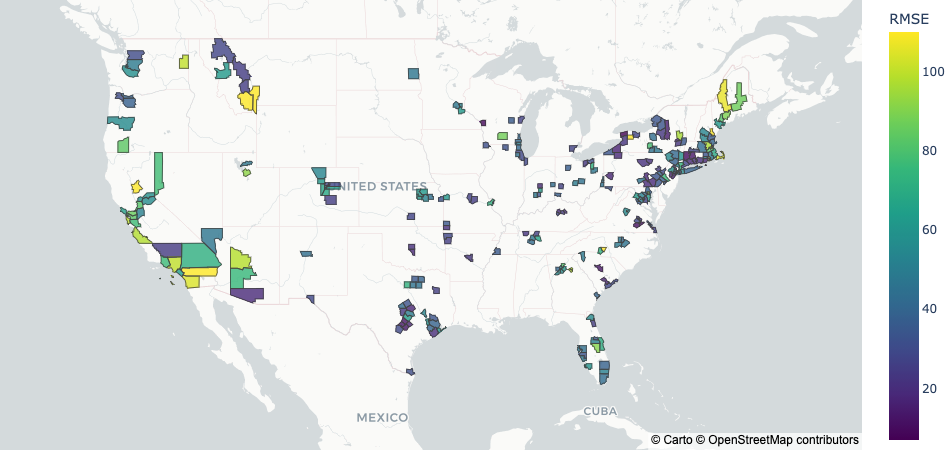

In [71]:
fig = px.choropleth_mapbox(zip_county_mean, geojson=counties, locations='COUNTY', color='RMSE',
                           color_continuous_scale="Viridis",
                           range_color=(7, 110),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.8,
                           labels={'RMSE':'RMSE'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},
                 width=800, height=450)
fig.show()



# folium.Choropleth(
#     geo_data=counties,
#     name="Counties",
#     data=zip_county_mean_test,
#     columns=["COUNTY", "1"],
#     key_on="feature.id",
#     fill_color="BuPu",
# #     bins=[0, 10, 15, 20, 25, 30, 35, 45],
#     fill_opacity=.5,
# #     line_opacity=0.00001,
#     line_weight = 0.3,
#     legend_name="Playing around",
#     highlight=True,
# ).add_to(m)

# folium.LayerControl().add_to(m)

# m

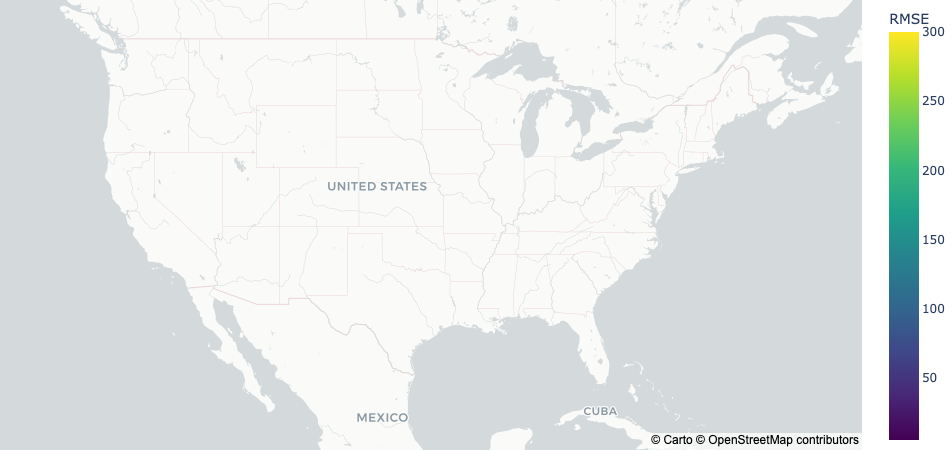

In [93]:
fig = px.choropleth_mapbox(rmse_XGB_resids_auto_only_df, geojson=geoj_file, locations='zip', color='RMSE',
                           color_continuous_scale="Viridis",
                           range_color=(5, 300),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=1,
                           labels={'RMSE':'RMSE'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},
                 width=800, height=450)
fig.show()


In [102]:
rmse_XGB_resids_auto_only_df[rmse_XGB_resids_auto_only_df['zip'] == "33161"]

,zip,RMSE
,,
650,33161,9.084436


In [83]:
geoj_file

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'ZCTA5CE10': '33161',
    'AFFGEOID10': '8600000US33161',
    'GEOID10': '33161',
    'ALAND10': 14162783,
    'AWATER10': 146965},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-80.19987, 25.909864],
      [-80.199735, 25.910341],
      [-80.199572, 25.910764],
      [-80.199641, 25.912583],
      [-80.199677, 25.913234],
      [-80.195551, 25.913238],
      [-80.190878, 25.912324],
      [-80.18766, 25.915856],
      [-80.187543, 25.913545],
      [-80.186652, 25.913942],
      [-80.175535, 25.914314],
      [-80.171495, 25.914468],
      [-80.171481, 25.914013],
      [-80.167457, 25.914156],
      [-80.16644, 25.893339],
      [-80.164838, 25.893392],
      [-80.164749, 25.890673],
      [-80.166311, 25.890601],
      [-80.166007, 25.883651],
      [-80.166232, 25.882702],
      [-80.169986, 25.882518],
   

In [95]:
geoj_file

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'ZCTA5CE10': '33161',
    'AFFGEOID10': '8600000US33161',
    'zip': '33161',
    'ALAND10': 14162783,
    'AWATER10': 146965},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-80.19987, 25.909864],
      [-80.199735, 25.910341],
      [-80.199572, 25.910764],
      [-80.199641, 25.912583],
      [-80.199677, 25.913234],
      [-80.195551, 25.913238],
      [-80.190878, 25.912324],
      [-80.18766, 25.915856],
      [-80.187543, 25.913545],
      [-80.186652, 25.913942],
      [-80.175535, 25.914314],
      [-80.171495, 25.914468],
      [-80.171481, 25.914013],
      [-80.167457, 25.914156],
      [-80.16644, 25.893339],
      [-80.164838, 25.893392],
      [-80.164749, 25.890673],
      [-80.166311, 25.890601],
      [-80.166007, 25.883651],
      [-80.166232, 25.882702],
      [-80.169986, 25.882518],
      [

In [96]:
counties

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'GEO_ID': '0500000US08013',
    'STATE': '08',
    'COUNTY': '013',
    'NAME': 'Boulder',
    'LSAD': 'County',
    'CENSUSAREA': 726.289},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-105.055089, 40.261793],
      [-105.055375, 40.144929],
      [-105.055376, 40.144692],
      [-105.055432, 40.000251],
      [-105.052823, 40.00026],
      [-105.052774, 39.986398],
      [-105.052792, 39.979489],
      [-105.052793, 39.97879],
      [-105.052794, 39.978581],
      [-105.052797, 39.977574],
      [-105.054688, 39.976889],
      [-105.057654, 39.97586],
      [-105.05784, 39.975787],
      [-105.058567, 39.975502],
      [-105.060445, 39.974768],
      [-105.060968, 39.974563],
      [-105.063527, 39.973444],
      [-105.066609, 39.971925],
      [-105.06742, 39.971289],
      [-105.069605, 39.970227],
      [-105.070468, 39.969721],
      [-105.071886, 39.968544],
      [-105.073059, 39.96730

In [154]:
XGB_resids_auto_only_df['residual']=XGB_resids_auto_only_df['zri_predict']-XGB_resids_auto_only_df['zri_actual']
XGB_resids_auto_only_df['residual_squared']=XGB_resids_auto_only_df['residual'].map(lambda x: x**2)
rmse_table=XGB_resids_auto_only_df.groupby('State')[['residual_squared']].agg(['sum','count'])
rmse_table['residual_avgd']=rmse_table['residual_squared']['sum']/rmse_table['residual_squared']['count']
rmse_table['residual_avgd']=rmse_table['residual_avgd'].apply(lambda x: x**0.5)
STATE_rmse_XGB_resids_auto_only_df = rmse_table[['residual_avgd']].reset_index().rename(columns={'residual_avgd': "RMSE"})


In [155]:
STATE_rmse_XGB_resids_auto_only_df

,State,RMSE
,,
0,AK,57.133300
1,AR,26.781246
2,AZ,79.158611
3,CA,109.738034
4,CO,61.529219
5,CT,23.816122
6,DC,79.629743
7,FL,56.449127
8,GA,63.099960


In [163]:
STATE_rmse_XGB_resids_auto_only_df['State'] = STATE_rmse_XGB_resids_auto_only_df['State'].map(abbrev_to_us_state)

In [159]:
us_state_to_abbrev = {
    "Alabama": "AL",
    "Alaska": "AK",
    "Arizona": "AZ",
    "Arkansas": "AR",
    "California": "CA",
    "Colorado": "CO",
    "Connecticut": "CT",
    "Delaware": "DE",
    "Florida": "FL",
    "Georgia": "GA",
    "Hawaii": "HI",
    "Idaho": "ID",
    "Illinois": "IL",
    "Indiana": "IN",
    "Iowa": "IA",
    "Kansas": "KS",
    "Kentucky": "KY",
    "Louisiana": "LA",
    "Maine": "ME",
    "Maryland": "MD",
    "Massachusetts": "MA",
    "Michigan": "MI",
    "Minnesota": "MN",
    "Mississippi": "MS",
    "Missouri": "MO",
    "Montana": "MT",
    "Nebraska": "NE",
    "Nevada": "NV",
    "New Hampshire": "NH",
    "New Jersey": "NJ",
    "New Mexico": "NM",
    "New York": "NY",
    "North Carolina": "NC",
    "North Dakota": "ND",
    "Ohio": "OH",
    "Oklahoma": "OK",
    "Oregon": "OR",
    "Pennsylvania": "PA",
    "Rhode Island": "RI",
    "South Carolina": "SC",
    "South Dakota": "SD",
    "Tennessee": "TN",
    "Texas": "TX",
    "Utah": "UT",
    "Vermont": "VT",
    "Virginia": "VA",
    "Washington": "WA",
    "West Virginia": "WV",
    "Wisconsin": "WI",
    "Wyoming": "WY",
    "District of Columbia": "DC",
    "American Samoa": "AS",
    "Guam": "GU",
    "Northern Mariana Islands": "MP",
    "Puerto Rico": "PR",
    "United States Minor Outlying Islands": "UM",
    "U.S. Virgin Islands": "VI",
}
    
# invert the dictionary
abbrev_to_us_state = dict(map(reversed, us_state_to_abbrev.items()))

In [156]:
with open("../../data/gz_2010_us_040_00_500k.json") as geofile:
    state_geoj_file = json.load(geofile)

In [182]:
state_geoj_file['features'][0]['properties']['NAME']

'Maine'

In [165]:
output_dict = [x for x in state_geoj_file['features'] if x['NAME'] in STATE_rmse_XGB_resids_auto_only_df['State']]
state_geoj_file['features'] = output_dict
state_json = json.dumps(state_geoj_file)

KeyError: 'NAME'

In [201]:
m = folium.Map(width=700,height=400, location=[37, -95], zoom_start=4.25, tiles = "cartodbpositron")

folium.Choropleth(
    geo_data=state_geoj_file,
    name="NAME",
    data=STATE_rmse_XGB_resids_auto_only_df,
    columns=["State", "RMSE"],
    key_on="feature.properties.NAME",
    fill_color="BuPu",
#     bins=[7, 15, 30, 50, 70, 90, 110, 302],
    fill_opacity=1,
#     line_opacity=0.00001,
    line_weight = 0.3,
    legend_name="RMSE",
    highlight=True,
).add_to(m)

# folium.LayerControl().add_to(m)

m